# Analisis Data Airbnb New York City

by

# Rizal Farhan Nanda (3.34.23.3.20) & Rizqi Aditya Pratama (3.34.23.3.21)

# Introduction

Notebook ini merupakan bagian dari tugas **Ujian Tengah Semester (UTS)** untuk mata kuliah *Kecerdasan Buatan*.  

Analisis ini menggunakan dataset **Airbnb**, yang berisi informasi mengenai properti sewaan jangka pendek di wilayah New York, termasuk data lokasi, harga, jenis kamar, dan wilayah administratif.

Tujuan dari analisis ini adalah untuk:
- Memahami persebaran properti Airbnb berdasarkan lokasi.
- Menganalisis tren harga sewa pada berbagai wilayah.
- Menggambarkan karakteristik umum listing Airbnb di New York City.

Dataset ini bersumber dari data publik Airbnb dan digunakan untuk keperluan **pembelajaran dan eksplorasi data**.

# Import library

In [21]:
# Import library numpy untuk operasi numerik seperti array, statistik, dll
import numpy as np

# Import library pandas untuk manipulasi dan analisis data berbasis tabel (DataFrame)
import pandas as pd

# Import matplotlib (core) dan modul pyplot untuk membuat visualisasi statis (grafik, plot, dll)
import matplotlib
import matplotlib.pyplot as plt

# Import seaborn untuk visualisasi statistik yang lebih menarik dan informatif
import seaborn as sns

import plotly.express as px

## Load and Explore the Data

In [22]:
df_airbnb = pd.read_csv('./airbnb.csv')
df_airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [23]:
# menampilkan informasi dasar dataset
df_airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

In [24]:
df_airbnb.shape

(48895, 16)

In [25]:
# menampilkan data statistik dataset
df_airbnb.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [26]:
# cek missing values
df_airbnb.isnull().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

In [27]:
# Cek baris yang duplikat
df_airbnb.duplicated()

0        False
1        False
2        False
3        False
4        False
         ...  
48890    False
48891    False
48892    False
48893    False
48894    False
Length: 48895, dtype: bool

## Data Cleaning and Preprocessing

### Handle Missing Values

In [28]:
# Mengisi kolom 'name' dan 'host_name' yang hilang dengan 'Unknown'
df_airbnb['name'] = df_airbnb['name'].fillna('Unknown')
df_airbnb['host_name'] = df_airbnb['host_name'].fillna('Unknown')

# Mengisi 'reviews_per_month' dengan 0, karena tidak ada review
df_airbnb['reviews_per_month'] = df_airbnb['reviews_per_month'].fillna(0)

# Menghapus baris yang hilang pada kolom 'last_review'
df_airbnb = df_airbnb.dropna(subset=['last_review'])

In [29]:
# cek missing values
df_airbnb.isnull().sum()

id                                0
name                              0
host_id                           0
host_name                         0
neighbourhood_group               0
neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
price                             0
minimum_nights                    0
number_of_reviews                 0
last_review                       0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
dtype: int64

# Exploratory Data Analysis

## Persebaran Lokasi Properti Airbnb

### Jumlah Listing Airbnb per Wilayah di New York City

In [24]:
df_airbnb['neighbourhood_group'].value_counts(ascending=False)

neighbourhood_group
Manhattan        16632
Brooklyn         16447
Queens            4574
Bronx              876
Staten Island      314
Name: count, dtype: int64

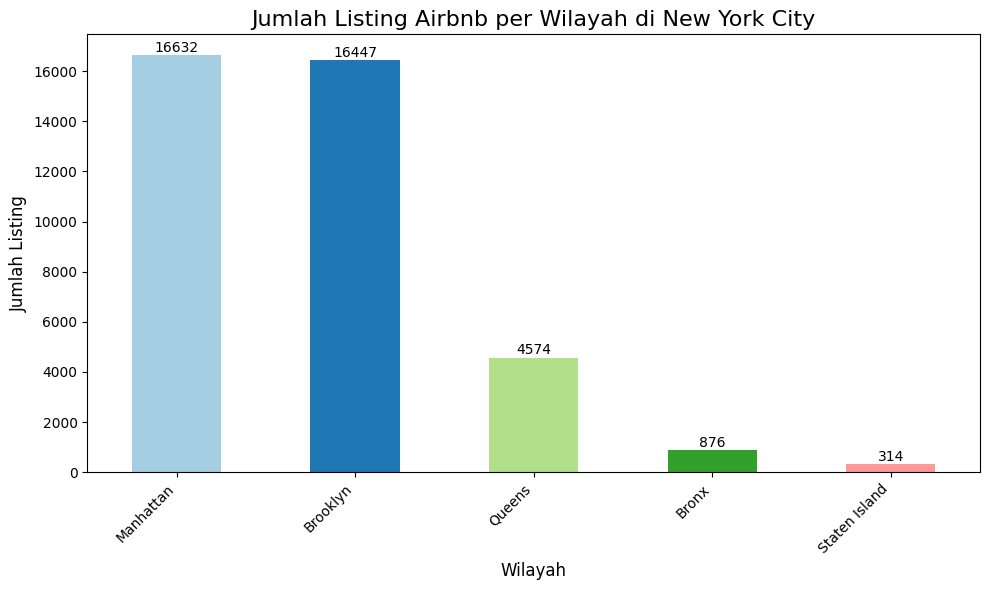

In [25]:
# Hitung jumlah listing per neighbourhood_group
neighbourhood_counts = df_airbnb['neighbourhood_group'].value_counts()

# Membuat diagram batang dengan warna berbeda
plt.figure(figsize=(10, 6))  # Menentukan ukuran plot
neighbourhood_counts.plot(kind='bar', color=plt.cm.Paired(range(len(neighbourhood_counts))))  # Menggunakan colormap 'Paired'

# Menambahkan judul dan label
plt.title("Jumlah Listing Airbnb per Wilayah di New York City", fontsize=16)
plt.xlabel("Wilayah", fontsize=12)
plt.ylabel("Jumlah Listing", fontsize=12)

# Menambahkan label pada setiap batang
for i, count in enumerate(neighbourhood_counts):
    plt.text(i, count + 10, str(count), ha='center', va='bottom', fontsize=10)

# Menampilkan plot
plt.xticks(rotation=45, ha='right')  # Rotasi label sumbu X agar lebih mudah dibaca
plt.tight_layout()  # Agar layout tidak terpotong
plt.show()

### Penyebaran Lokasi Properti Airbnb di New York Berdasarkan Neighborhood

Peta di bawah ini menunjukkan penyebaran geografis daftar Airbnb di kota New York

In [26]:
# Buat peta interaktif menggunakan Plotly Express
fig = px.scatter_map(
    df_airbnb,  # DataFrame yang digunakan
    lat="latitude",  # Kolom latitude
    lon="longitude",  # Kolom longitude
    color="neighbourhood_group",  # Pewarnaan berdasarkan wilayah
    hover_name="name",  # Nama listing tampil saat hover
    hover_data={"price": True, "room_type": True, "latitude": False, "longitude": False},  # Info tambahan
    zoom=9,  # Level zoom awal
    center={"lat": 40.7128, "lon": -74.0060},  # Pusat peta (New York City)
    opacity=0.6,  # Transparansi marker
    height=800,  # Tinggi peta
    width=1000,  # Lebar peta
)

# Style
fig.update_layout(mapbox_style="open-street-map")

# Tampilkan peta
fig.show()

## Analisis Tipe Kamar, Malam Minimum, dan Ketersediaan

### Room Type Analysis

#### Jumlah Listing per Room Type di Airbnb

In [27]:
df_airbnb['room_type'].value_counts(ascending=False)

room_type
Entire home/apt    20332
Private room       17665
Shared room          846
Name: count, dtype: int64

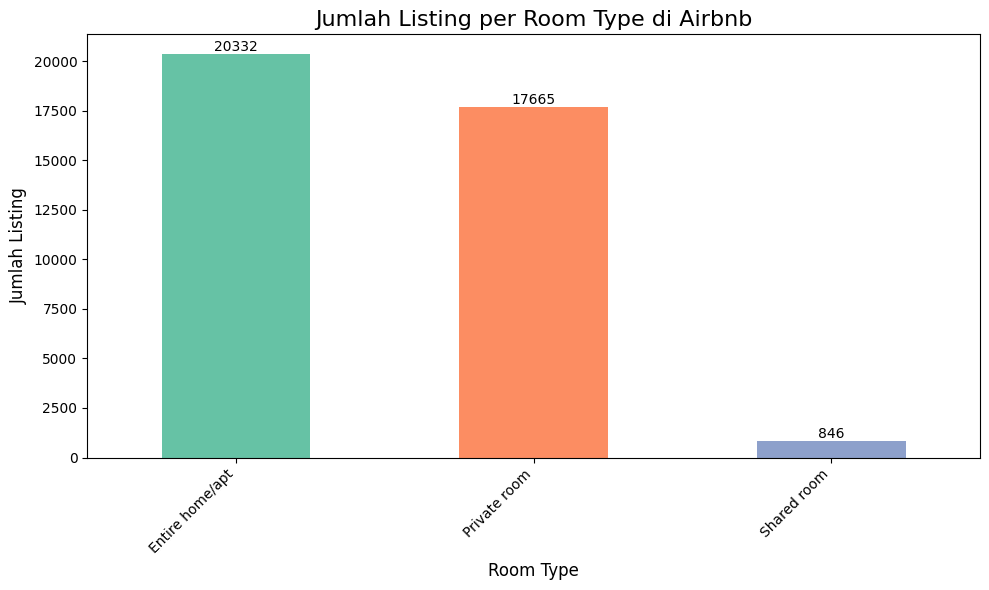

In [28]:
# Hitung jumlah listing per room_type
room_type_counts = df_airbnb['room_type'].value_counts(ascending=False)

# Membuat diagram batang dengan warna berbeda
colors = plt.cm.Set2(range(len(room_type_counts)))  # Warna berbeda untuk setiap batang

plt.figure(figsize=(10, 6))  # Menentukan ukuran plot
room_type_counts.plot(kind='bar', color=colors)  # Plot batang dengan warna berbeda

# Menambahkan judul dan label
plt.title('Jumlah Listing per Room Type di Airbnb', fontsize=16)
plt.xlabel('Room Type', fontsize=12)
plt.ylabel('Jumlah Listing', fontsize=12)

# Menambahkan label pada setiap batang
for i, count in enumerate(room_type_counts):
    plt.text(i, count + 10, str(count), ha='center', va='bottom', fontsize=10)

# Menampilkan plot
plt.xticks(rotation=45, ha='right')  # Rotasi label sumbu X agar lebih mudah dibaca
plt.tight_layout()  # Agar layout tidak terpotong
plt.show()

#### Rata-rata Ketersediaan Berdasarkan Room Type

In [37]:
# Kelompokkan data berdasarkan jenis kamar (room_type), lalu hitung rata-rata ketersediaan per tahun (availability_365)
availability_by_type = df_airbnb.groupby('room_type')['availability_365'].mean().sort_values(ascending=False)

# Buat tabel
availability_table = pd.DataFrame(availability_by_type).reset_index()

# Ubah nama kolom agar lebih deskriptif
availability_table.columns = ['Room Type', 'Rata-rata Hari Tersedia per Tahun']

# Tampilkan tabel
print(availability_table)

         Room Type  Rata-rata Hari Tersedia per Tahun
0      Shared room                         165.998818
1     Private room                         116.473648
2  Entire home/apt                         111.373893


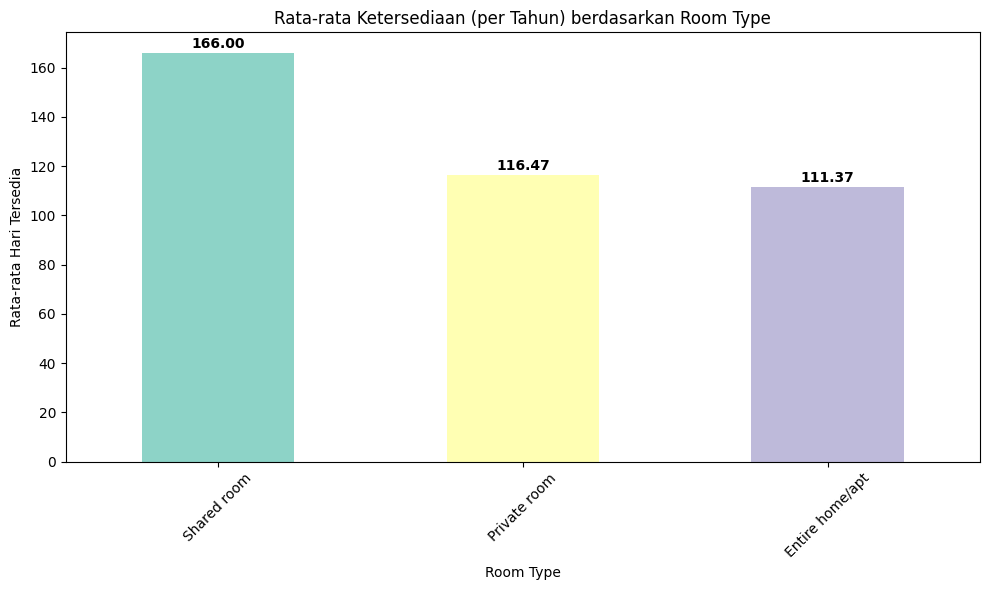

In [36]:
# Kelompokkan data berdasarkan jenis kamar (room_type), lalu hitung rata-rata ketersediaan per tahun (availability_365)
availability_by_type = df_airbnb.groupby('room_type')['availability_365'].mean().sort_values(ascending=False)

# Buat figure untuk visualisasi dengan ukuran tertentu
plt.figure(figsize=(10, 6))

# Plot data dalam bentuk bar chart, gunakan skema warna dari colormap 'Set3'
availability_by_type.plot(kind='bar', color=plt.cm.Set3(range(len(availability_by_type))))

# Judul grafik
plt.title('Rata-rata Ketersediaan (per Tahun) berdasarkan Room Type')

# Label sumbu X
plt.xlabel('Room Type')

# Label sumbu Y
plt.ylabel('Rata-rata Hari Tersedia')

# Rotasi label sumbu X agar tidak bertumpuk
plt.xticks(rotation=45)

# Tampilkan jumlah di atas setiap bar
for index, value in enumerate(availability_by_type):
    plt.text(index, value + 2, f'{value:.2f}', ha='center', fontsize=10, fontweight='bold')

# Atur layout agar elemen-elemen grafik tidak terpotong
plt.tight_layout()

# Tampilkan grafik
plt.show()


#### Jumlah Listing per Room Type dan Neighbourhood Group

In [31]:
# Hitung jumlah listing per room_type dan wilayah
room_demand = df_airbnb.groupby(['neighbourhood_group', 'room_type']).size().unstack().fillna(0)
room_demand

room_type,Entire home/apt,Private room,Shared room
neighbourhood_group,,,
Bronx,309,524,43
Brooklyn,8164,7993,290
Manhattan,9967,6309,356
Queens,1742,2680,152
Staten Island,150,159,5


In [50]:
import plotly.express as px

# Hitung jumlah listing per kombinasi wilayah dan room_type
room_demand_long = df_airbnb.groupby(['neighbourhood_group', 'room_type']).size().reset_index(name='count')

# Buat diagram batang terpisah (grouped bar)
fig = px.bar(
    room_demand_long,
    x='neighbourhood_group',      # Sumbu X: wilayah
    y='count',                    # Sumbu Y: jumlah listing
    color='room_type',            # Warna berdasarkan tipe kamar
    title='Jumlah Listing Airbnb per Room Type dan Wilayah di New York City',
    labels={
        'neighbourhood_group': 'Wilayah',
        'count': 'Jumlah Listing',
        'room_type': 'Tipe Kamar'
    },
    barmode='group',              # Batang dipisah berdasarkan tipe kamar
    height=600
)

# Tampilkan grafik
fig.show()

### Minimum Nights Analysis

In [30]:
df_airbnb['minimum_nights'].describe()

count    38843.000000
mean         5.868059
std         17.384784
min          1.000000
25%          1.000000
50%          2.000000
75%          4.000000
max       1250.000000
Name: minimum_nights, dtype: float64

#### Rata-rata Jumlah Malam Minimum Berdasarkan Room Type dan Neighbourhood Group

In [31]:
average_minimum_nights=df_airbnb.groupby(["neighbourhood_group", "room_type"])['minimum_nights'].mean().reset_index().sort_values('minimum_nights',ascending=False).round(2)
average_minimum_nights

,neighbourhood_group,room_type,minimum_nights
6,Manhattan,Entire home/apt,8.61
5,Brooklyn,Shared room,6.23
3,Brooklyn,Entire home/apt,5.91
0,Bronx,Entire home/apt,5.64
4,Brooklyn,Private room,4.69
7,Manhattan,Private room,4.69
9,Queens,Entire home/apt,4.37
10,Queens,Private room,4.13
11,Queens,Shared room,4.09
12,Staten Island,Entire home/apt,3.87


In [51]:
# Misalkan df_airbnb adalah DataFrame yang sudah ada dan berisi data
average_minimum_nights = df_airbnb.groupby(["neighbourhood_group", "room_type"])['minimum_nights'].mean().reset_index().sort_values('minimum_nights',ascending=False).round(2)

# Membuat diagram batang menggunakan Plotly
fig = px.bar(average_minimum_nights,
             x='neighbourhood_group',
             y='minimum_nights',
             color='room_type',
             barmode='group',
             title="Rata-rata Jumlah Malam Minimum berdasarkan Room Type dan Neighbourhood Group",
             labels={'minimum_nights': 'Rata-rata Minimum Nights', 'neighbourhood_group': 'Neighbourhood Group'},
             color_discrete_sequence=px.colors.qualitative.Set2)

# Menampilkan diagram
fig.update_layout(xaxis_title='Neighbourhood Group', yaxis_title='Rata-rata Minimum Nights', xaxis_tickangle=45)
fig.show()

## Analisis Harga dan Rating Listing Airbnb

In [36]:
# Tampilkan statistik deskriptif harga
price_stats = df_airbnb['price'].describe()

# Menampilkan tabel
price_stats

count    38843.000000
mean       142.317947
std        196.945624
min          0.000000
25%         69.000000
50%        101.000000
75%        170.000000
max      10000.000000
Name: price, dtype: float64

### Harga Rata-rata per Room Type di Airbnb

In [40]:
# Menghitung rata-rata harga per room_type
average_price_per_room_type = df_airbnb.groupby('room_type')['price'].mean().sort_values(ascending=False).round(2)

# Menampilkan tabel
average_price_per_room_type

room_type
Entire home/apt    196.29
Private room        83.98
Shared room         63.21
Name: price, dtype: float64

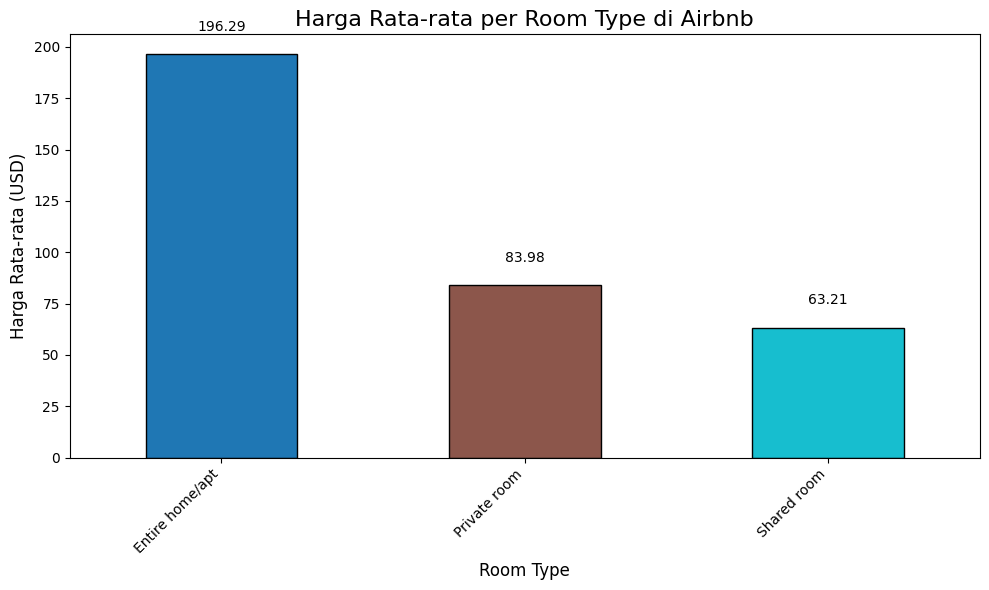

In [42]:
# Membuat diagram batang untuk harga rata-rata per room_type
plt.figure(figsize=(10, 6))

# Pilih palet warna untuk setiap kategori room_type
colors = plt.get_cmap('tab10', len(average_price_per_room_type))

# Plot batang dengan warna berbeda untuk setiap room_type
average_price_per_room_type.plot(kind='bar', color=colors(range(len(average_price_per_room_type))), edgecolor='black')

# Menambahkan judul dan label
plt.title('Harga Rata-rata per Room Type di Airbnb', fontsize=16)
plt.xlabel('Room Type', fontsize=12)
plt.ylabel('Harga Rata-rata (USD)', fontsize=12)

# Menambahkan label pada setiap batang
for i, value in enumerate(average_price_per_room_type):
    plt.text(i, value + 10, str(value), ha='center', va='bottom', fontsize=10)

# Menampilkan plot
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

### Relasi antara Harga dan Jumlah Ulasan pada Listing Airbnb

Plot di bawah ini menunjukkan hubungan antara **harga listing Airbnb** dan **jumlah ulasan** yang diterima oleh masing-masing listing. Setiap titik merepresentasikan satu properti.

Dari visualisasi ini, dapat diamati bahwa:
- Sebagian besar listing dengan **harga rendah hingga menengah** cenderung memiliki **jumlah ulasan lebih banyak**.
- Sebaliknya, **listing dengan harga sangat tinggi** umumnya memiliki **ulasan yang lebih sedikit**, yang mungkin disebabkan oleh lebih rendahnya jumlah penyewa.

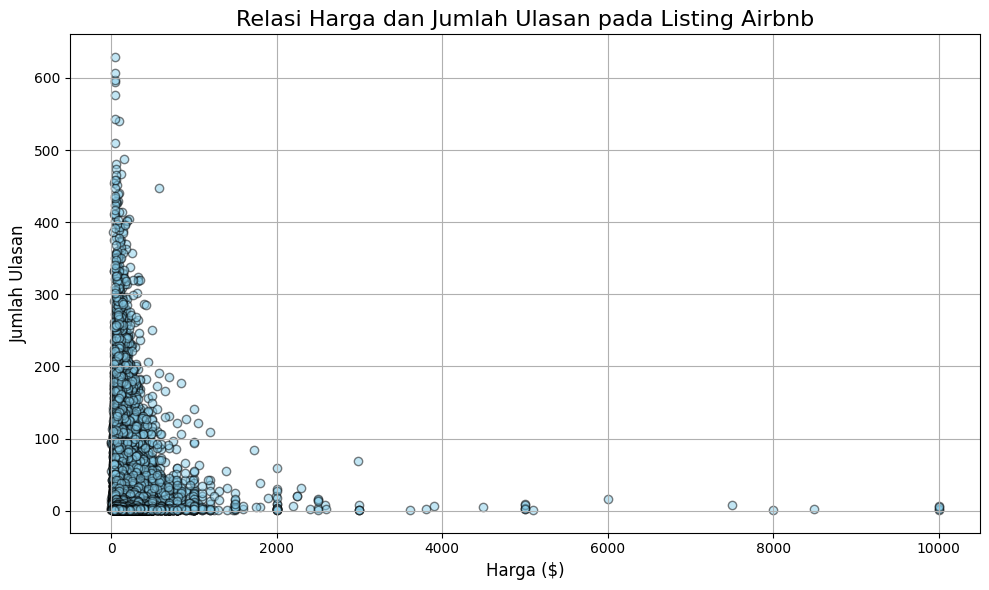

In [39]:
plt.figure(figsize=(10, 6))
plt.scatter(df_airbnb['price'], df_airbnb['number_of_reviews'], alpha=0.5, color='skyblue', edgecolor='black')

plt.title('Relasi Harga dan Jumlah Ulasan pada Listing Airbnb', fontsize=16)
plt.xlabel('Harga ($)', fontsize=12)
plt.ylabel('Jumlah Ulasan', fontsize=12)

plt.grid(True)
plt.tight_layout()
plt.show()

### Harga Rata-rata per Neighbourhood Group di Airbnb

In [18]:
# Hitung rata-rata harga per neighbourhood_group
neighbourhood_avg_price = df_airbnb.groupby('neighbourhood_group')['price'].mean().round(2)

# Menampilkan tabel harga rata-rata per neighbourhood_group
neighbourhood_avg_price

neighbourhood_group
Bronx             79.55
Brooklyn         121.45
Manhattan        180.05
Queens            95.76
Staten Island     89.96
Name: price, dtype: float64

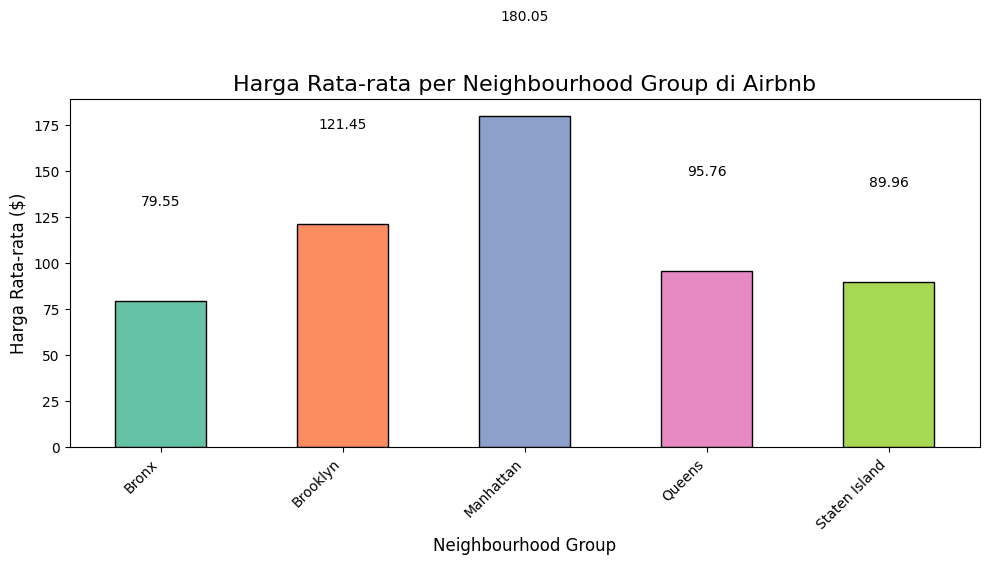

In [20]:
# Membuat diagram batang harga rata-rata per neighbourhood_group
plt.figure(figsize=(10, 6))

# Mengambil colormap agar warna batang berbeda
colors = plt.cm.Set2(range(len(neighbourhood_avg_price)))

neighbourhood_avg_price.plot(kind='bar', color=colors, edgecolor='black')

# Menambahkan judul dan label
plt.title('Harga Rata-rata per Neighbourhood Group di Airbnb', fontsize=16)
plt.xlabel('Neighbourhood Group', fontsize=12)
plt.ylabel('Harga Rata-rata ($)', fontsize=12)

# Menambahkan label pada setiap batang
for i, value in enumerate(neighbourhood_avg_price):
    plt.text(i, value + 50, round(value, 2), ha='center', va='bottom', fontsize=10)

# Menampilkan plot
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

### Host dengan Properti Terbanyak

In [43]:
top_hosts = df_airbnb['host_name'].value_counts().head(10).reset_index()
top_hosts.columns = ['Nama Host', 'Jumlah Properti']  # Ganti header kolomnya
top_hosts  # Tampilkan tabel


,Nama Host,Jumlah Properti
0,Michael,335
1,David,309
2,John,250
3,Alex,229
4,Sonder (NYC),207
5,Sarah,179
6,Maria,174
7,Jessica,170
8,Daniel,170
9,Anna,160


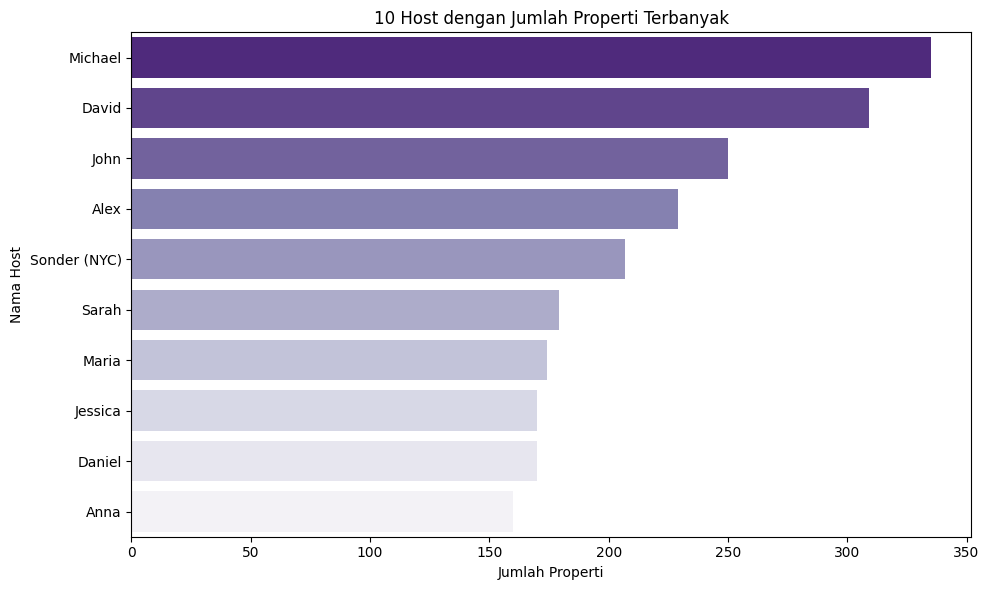

In [45]:
# Membuat figure dengan ukuran tertentu
plt.figure(figsize=(10, 6))

# Membuat barplot untuk menampilkan jumlah properti per host
sns.barplot(data=top_hosts, x='Jumlah Properti', y='Nama Host', palette='Purples_r', hue='Nama Host', legend=False)

# Menambahkan judul pada diagram
plt.title('10 Host dengan Jumlah Properti Terbanyak')

# Menambahkan label pada sumbu X
plt.xlabel('Jumlah Properti')

# Menambahkan label pada sumbu Y
plt.ylabel('Nama Host')

# Menggunakan tight_layout agar elemen plot tidak terpotong
plt.tight_layout()

# Menampilkan plot
plt.show()

### Properti dengan Review Terbanyak

In [46]:
top_reviews = df_airbnb.sort_values(by='number_of_reviews', ascending=False).head(10)
top_reviews[['name', 'neighbourhood_group', 'room_type', 'price', 'number_of_reviews']]

,name,neighbourhood_group,room_type,price,number_of_reviews
11759,Room near JFK Queen Bed,Queens,Private room,47,629
2031,Great Bedroom in Manhattan,Manhattan,Private room,49,607
2030,Beautiful Bedroom in Manhattan,Manhattan,Private room,49,597
2015,Private Bedroom in Manhattan,Manhattan,Private room,49,594
13495,Room Near JFK Twin Beds,Queens,Private room,47,576
10623,Steps away from Laguardia airport,Queens,Private room,46,543
1879,Manhattan Lux Loft.Like.Love.Lots.Look !,Manhattan,Private room,99,540
20403,Cozy Room Family Home LGA Airport NO CLEANING FEE,Queens,Private room,48,510
4870,Private brownstone studio Brooklyn,Brooklyn,Entire home/apt,160,488
471,LG Private Room/Family Friendly,Brooklyn,Private room,60,480


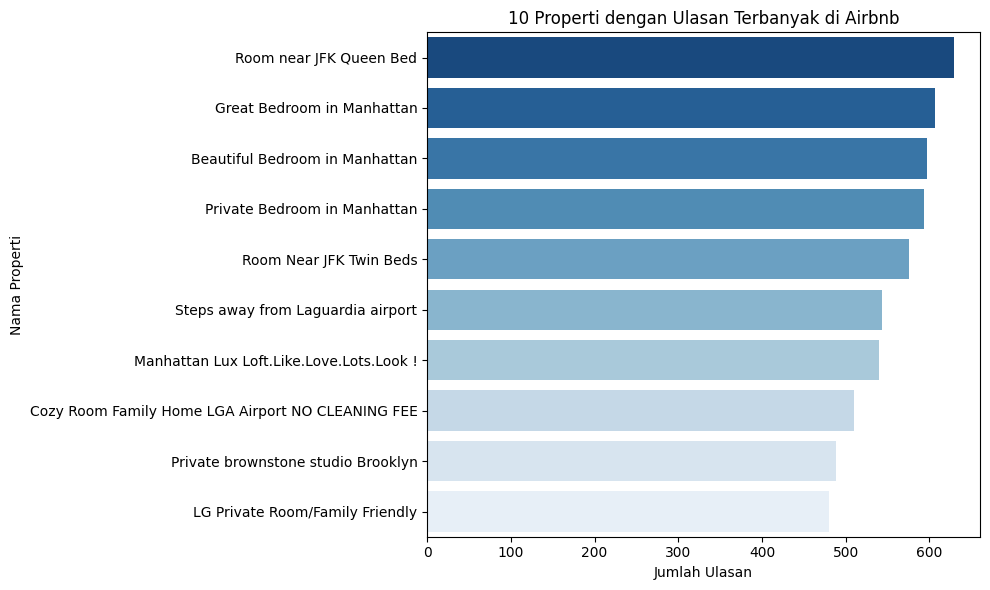

In [47]:
# Membuat figure dengan ukuran tertentu
plt.figure(figsize=(10, 6))

# Membuat barplot untuk menampilkan jumlah ulasan per properti
sns.barplot(data=top_reviews, x='number_of_reviews', y='name', palette='Blues_r', hue='name', legend=False)

# Menambahkan judul pada diagram
plt.title('10 Properti dengan Ulasan Terbanyak di Airbnb')

# Menambahkan label pada sumbu X
plt.xlabel('Jumlah Ulasan')

# Menambahkan label pada sumbu Y
plt.ylabel('Nama Properti')

# Menggunakan tight_layout agar elemen plot tidak terpotong
plt.tight_layout()

# Menampilkan plot
plt.show()

### Properti dengan Review per Bulan Tertinggi

In [48]:
top_rated = df_airbnb[df_airbnb['reviews_per_month'].notnull()]
top_rated = top_rated.sort_values(by='reviews_per_month', ascending=False).head(10)
top_rated[['name', 'neighbourhood_group', 'room_type', 'price', 'number_of_reviews', 'reviews_per_month']]

,name,neighbourhood_group,room_type,price,number_of_reviews,reviews_per_month
42075,Enjoy great views of the City in our Deluxe Room!,Manhattan,Private room,100,156,58.50
42076,Great Room in the heart of Times Square!,Manhattan,Private room,199,82,27.95
38870,Lou's Palace-So much for so little,Queens,Private room,45,37,20.94
27287,JFK Comfort.5 Mins from JFK Private Bedroom & ...,Queens,Private room,80,403,19.75
28651,JFK 2 Comfort 5 Mins from JFK Private Bedroom,Queens,Private room,50,341,17.82
29628,JFK 3 Comfort 5 Mins from JFK Private Bedroom,Queens,Private room,50,302,16.81
20403,Cozy Room Family Home LGA Airport NO CLEANING FEE,Queens,Private room,48,510,16.22
22469,Cute Tiny Room Family Home by LGA NO CLEANING FEE,Queens,Private room,48,436,16.03
36238,“For Heaven Cakes”,Queens,Entire home/apt,75,132,15.78
40297,Studio Apartment 6 minutes from JFK Airport,Queens,Private room,67,95,15.32


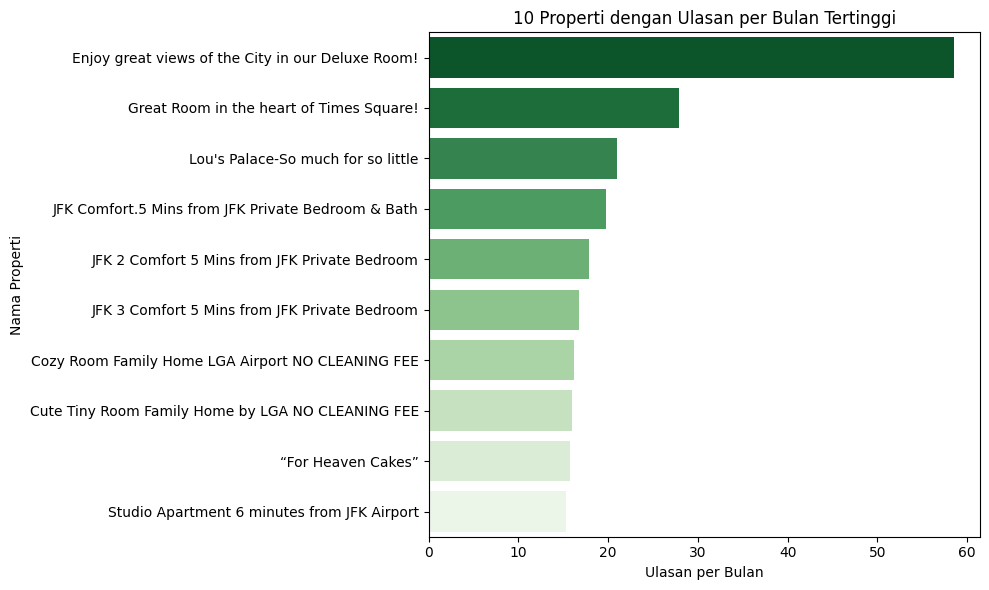

In [49]:
# Membuat figure dengan ukuran lebar 10 dan tinggi 6 inci
plt.figure(figsize=(10, 6))

# Membuat barplot untuk menampilkan rata-rata ulasan per bulan dari properti
# Menggunakan DataFrame 'top_rated', sumbu X adalah reviews_per_month, sumbu Y adalah nama properti
sns.barplot(data=top_rated, x='reviews_per_month', y='name', palette='Greens_r', hue='name', legend=False)

# Menambahkan judul pada plot
plt.title('10 Properti dengan Ulasan per Bulan Tertinggi')

# Menambahkan label pada sumbu X
plt.xlabel('Ulasan per Bulan')

# Menambahkan label pada sumbu Y
plt.ylabel('Nama Properti')

# Mengatur layout agar elemen plot tampil dengan rapi dan tidak terpotong
plt.tight_layout()

# Menampilkan plot ke layar
plt.show()


### Harga Rata-Rata per Tipe Kamar per Wilayah

In [70]:
# Membuat pivot table untuk menghitung rata-rata harga (price) berdasarkan kombinasi
pivot_price = df_airbnb.pivot_table(
    index='neighbourhood_group',  # Baris berdasarkan wilayah
    columns='room_type',          # Kolom berdasarkan tipe kamar
    values='price',               # Nilai yang dihitung adalah harga
    aggfunc='mean'                # Fungsi agregasi: rata-rata
).round(2)                        # Membulatkan hasil ke 2 angka desimal

# Menampilkan tabel pivot yang dihasilkan
pivot_price


room_type,Entire home/apt,Private room,Shared room
neighbourhood_group,,,
Bronx,120.79,57.09,56.93
Brooklyn,171.25,73.34,45.46
Manhattan,230.19,106.60,77.98
Queens,139.23,69.29,64.47
Staten Island,125.37,57.58,57.60


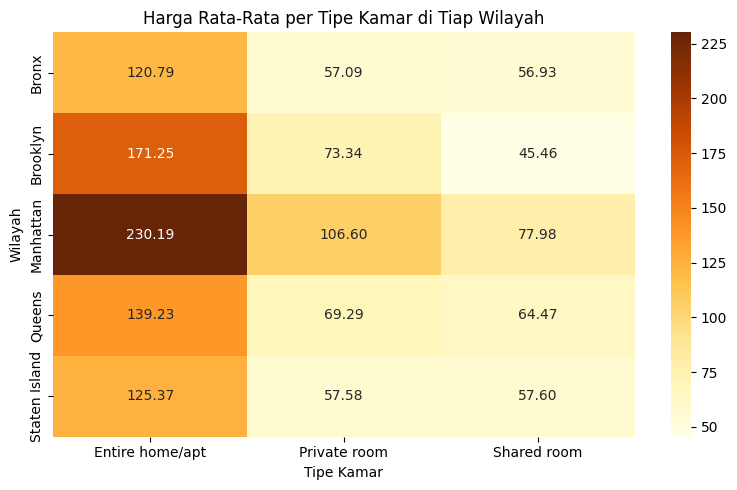

In [71]:
# Membuat figure dengan ukuran lebar 8 dan tinggi 5 inci
plt.figure(figsize=(8, 5))

# Membuat heatmap dari tabel pivot 'pivot_price' untuk menunjukkan harga rata-rata
# Setiap sel diisi dengan nilai dan diberi anotasi (annot=True) dengan format 2 angka desimal (fmt=".2f")
sns.heatmap(pivot_price, annot=True, fmt=".2f", cmap="YlOrBr")

# Menambahkan judul pada heatmap
plt.title('Harga Rata-Rata per Tipe Kamar di Tiap Wilayah')

# Menambahkan label pada sumbu X
plt.xlabel('Tipe Kamar')

# Menambahkan label pada sumbu Y
plt.ylabel('Wilayah')

# Mengatur layout agar elemen plot tampil rapi dan tidak terpotong
plt.tight_layout()

# Menampilkan heatmap ke layar
plt.show()
